# Wave-Particle Duality
Elijah Renner

Imports (run first):

In [6]:
!pip3 install ipython numpy matplotlib

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


## Background

### Electromagnetic Waves and their Vector Fields

Electromagnetic waves are waves that are formed when an electric field interacts with a magnetic field. 

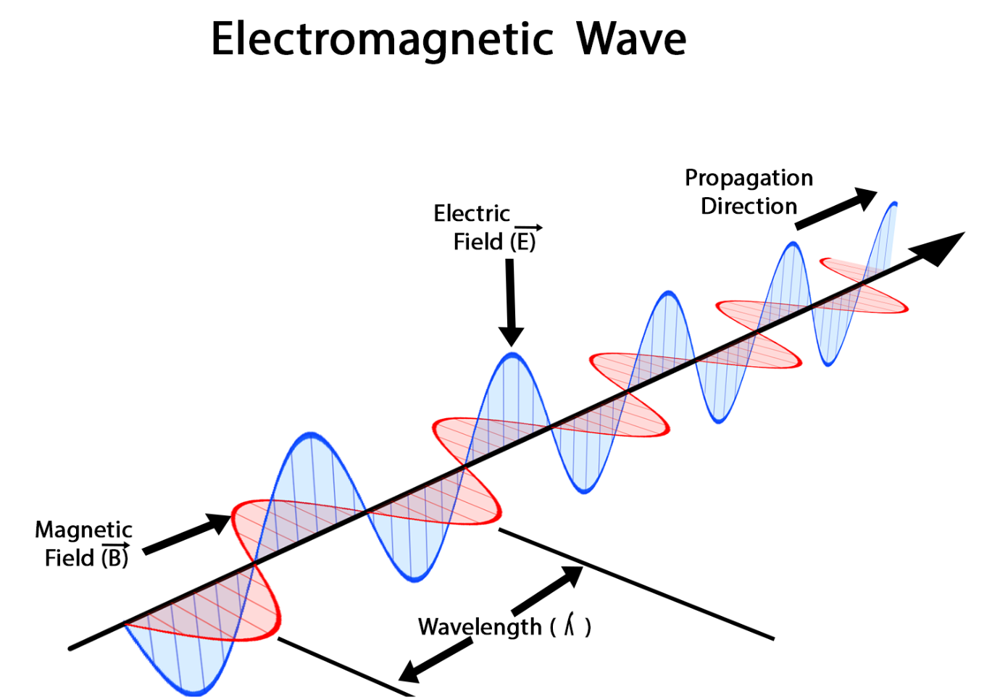

In [15]:
from IPython.display import Image, display

display(Image(filename='em_wave.jpeg'))

We can see that each point on this wave has a magnetic and electric field vector at each point $(x,y,z)$. Mathematically, we define these vector fields as 

$$\mathbf{E} = 
\begin{pmatrix}E_x\\[2pt]E_y\\[2pt]E_z\end{pmatrix},
\qquad
\mathbf{B} = 
\begin{pmatrix}B_x\\[2pt]B_y\\[2pt]B_z\end{pmatrix}.
$$

The unit for the electric field is $\frac{V}{m}$ or force per unit charge. The magnetic field is in teslas $(T)$, which quantify magnetic flux density, or how many “magnetic field-lines” pierce a tiny patch, and with what orientation.

### Calculus Concepts

It's helpful to understand a few operations. First we cover the curl. The curl measures local spin in a vector field. Take, for example, a 2D vector field with a spinning shape like

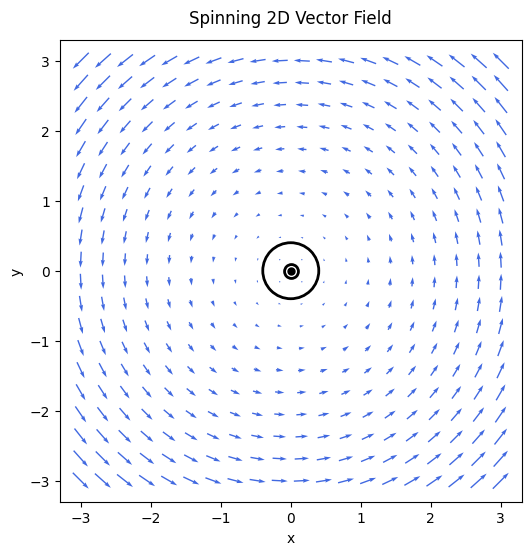

In [23]:
import matplotlib.pyplot as plt
import numpy as np

x, y = np.meshgrid(np.linspace(-3, 3, 20), np.linspace(-3, 3, 20))
u = -y
v = x

fig, ax = plt.subplots(figsize=(6,6))
ax.quiver(x, y, u, v, color='royalblue', pivot='mid')
ax.set_title("Spinning 2D Vector Field", pad=12)
ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_aspect('equal')
circle = plt.Circle((0, 0), 0.4, color='k', fill=False, linewidth=2)
ax.add_patch(circle)
ax.plot(0, 0, marker='o', markersize=10, color='k', markerfacecolor='w', markeredgewidth=2)
ax.plot(0, 0, marker='.', markersize=10, color='k')  # dot in the center

plt.show()


Now, imagine placing a floating object in the center. It will spin counterclockwise around an axis at $(x,y)=(0,0)$ as shown by the black dot protruding through the screen. That spin axis is the direction of the curl. So, at the highest level, the curl allows us to measure the "twist" content of a vector field by converting qualitative swirling observations into a precise vector quantity.

**The curl:** 
> “how, and around which axis, is this vector field trying to rotate things right here?” 

A more formal Cartesian definition of the curl is that a vector field $\mathbf{F}=\begin{pmatrix}F_x\\[2pt]F_y\\[2pt]F_z\end{pmatrix}$ has the curl $$\nabla \times \mathbf{F}=
\begin{pmatrix}
\dfrac{\partial F_z}{\partial y} - \dfrac{\partial F_y}{\partial z}\\[6pt]
\dfrac{\partial F_x}{\partial z} - \dfrac{\partial F_z}{\partial x}\\[6pt]
\dfrac{\partial F_y}{\partial x} - \dfrac{\partial F_x}{\partial y}
\end{pmatrix}.$$

## Wave Model

### Faraday's Law

Faraday's Law states that $$\nabla \times \mathbf{E}=-\frac{\partial \mathbf{B}}{\partial t}$$

The LHS (curl of $\mathbf{E}$) measures how strongly the electric field is swirling at each point. The RHS is the negative rate at which the magnetic field's flux density is changing at that point is changing in time.

Essentially, a magnetic field that is changing in time $\left(\frac{\partial \mathbf{B}}{\partial t}\neq0\right)$ creates a circulating electric field whose swirl strength exactly matches that time-change, with a direction that opposes the change.

The following demonstration gives some intuition for how the changing magnetic field induces an electric field:

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# ---------- physical parameters ----------
B0, freq = 0.10, 1.0        # Tesla, Hz
ω        = 2 * np.pi * freq # angular frequency (rad/s)

# ---------- grid for E-field ----------
rmax, N = 1.0, 19           # metres, grid resolution
x = np.linspace(-rmax, rmax, N)
y = np.linspace(-rmax, rmax, N)
X, Y = np.meshgrid(x, y)

# ---------- time base ----------
fps = 30                     # frames per second
cycles = 2
frames_per_cycle = 60        # frames per cycle
frames_total = cycles * frames_per_cycle
t_series = np.arange(frames_total) / fps
B_series    = B0 * np.sin(ω * t_series)
dBdt_series = B0 * ω * np.cos(ω * t_series)

# ---------- figure layout ----------
fig, (ax_field, ax_time) = plt.subplots(
    2, 1, figsize=(8, 8),
    gridspec_kw={'height_ratios': [4, 1]}
)
fig.subplots_adjust(hspace=0.4)
fig.suptitle(
    'Top: Induced electric field E swirling per Faraday’s law\n'
    'Bottom: Magnetic field B(t) and rate of change dB/dt vs time',
    fontsize=14,
    y=0.97
)

# top panel: induced E field
ax_field.set(aspect='equal', xlim=(-rmax, rmax), ylim=(-rmax, rmax),
             xlabel=r'$x\ (\mathrm{m})$', ylabel=r'$y\ (\mathrm{m})$')
ax_field.grid(alpha=0.3)
quiv = ax_field.quiver(X, Y, np.zeros_like(X), np.zeros_like(Y),
                       scale_units='xy', scale=1, width=0.005, color='teal')
txt_vals = ax_field.text(0.5, 1.02, '', transform=ax_field.transAxes,
                         ha='center', va='bottom', fontsize=10)

# bottom panel: B(t) and dB/dt traces
ax_time.plot(t_series, B_series,    label=r'$B(t)$')
ax_time.plot(t_series, dBdt_series, label=r'$dB/dt$')
cursor = ax_time.axvline(0, ls='--', lw=1, color='k')
ax_time.set(xlabel='Time (s)', ylabel='Value')
ax_time.legend(loc='upper right')
ax_time.grid(alpha=0.3)

# ---------- animation update ----------
def update(frame):
    dBdt = dBdt_series[frame]
    Ex =  0.5 * dBdt * Y
    Ey = -0.5 * dBdt * X
    quiv.set_UVC(Ex, Ey)

    t = t_series[frame]
    B = B_series[frame]
    txt_vals.set_text(
        fr'$t={t:.2f}\,\mathrm{{s}}\;\;B={B:+.3f}\,\mathrm{{T}}\;\;dB/dt={dBdt:+.3f}\,\mathrm{{T/s}}$'
    )
    cursor.set_xdata([t, t])
    return quiv, cursor, txt_vals

# ---------- run animation ----------
ani = FuncAnimation(fig, update, frames=frames_total,
                    interval=1000/fps, blit=True)
display(HTML(ani.to_jshtml()))
plt.close(fig)  # Prevents a static frame from being shown after the animation


Animation size has reached 21043459 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


**Resources:**
- https://physics.stackexchange.com/questions/512030/faraday-law-integral-and-differential-forms
- https://phys.libretexts.org/Bookshelves/University_Physics/Physics_(Boundless)/22%3A_Induction_AC_Circuits_and_Electrical_Technologies/22.1%3A_Magnetic_Flux_Induction_and_Faradays_Law
- https://eng.libretexts.org/Bookshelves/Electrical_Engineering/Electro-Optics/Book%3A_Electromagnetics_I_(Ellingson)/08%3A_Time-Varying_Fields/8.08%3A_The_Maxwell-Faraday_Equation

###

### Ampère–Maxwell Law

The Ampère–Maxwell Law states that

$$
\nabla \times \mathbf{B} \;=\;\mu_{0}\,\varepsilon_{0}\,\frac{\partial \mathbf{E}}{\partial t}
$$

The LHS (curl of $\mathbf{B}$) measures how strongly the magnetic field is swirling at each point. The RHS is the rate at which the electric field's flux density is changing at that point in time, scaled by the vacuum constants $\mu_{0}$ (magnetic permeability or measure of magnetization produced in a material in response to an applied magnetic field) and $\varepsilon_{0}$ (electric permittivity or electric polarizability). These constants represent how easily magnetic and electric fields can form in a vacuum - $\mu_{0}$ determines how readily a magnetic field can be established, while $\varepsilon_{0}$ determines how readily an electric field can be established.

Essentially, a changing electric field $\!\bigl(\tfrac{\partial \mathbf{E}}{\partial t}\neq0\bigr)$ creates a circulating magnetic field whose swirl strength exactly matches that time‐change.


**Resources:**
- https://phys.libretexts.org/Courses/Bowdoin_College/Phys1140%3A_Introductory_Physics_II%3A_Part_1/07%3A_Electromagnetic_Waves/7.02%3A_Maxwells_Equations_and_Electromagnetic_Waves
- https://www.maxwells-equations.com/ampere/amperes-law.php

### Combining Faraday's Law and the Ampère–Maxwell Law

With our knowledge of how a time-varying field $\mathbf{E}$ generates a curling magnetic field $\mathbf{B}$ (Ampère-Maxwell), and how $\mathbf{B}$ in turn generates a curling $\mathbf{E}$ (Faraday), we can derive the equation for the electromagnetic wave that arises from the disturbance and propagates at the speed of light $c=2.99792458\times 10^8 \frac{m}{s}$.

The derivation follows. First, take the curl of Faraday's law and substitute Ampère-Maxwell:
$$
\nabla \times (\nabla \times \mathbf{E}) = - \frac{\partial}{\partial t} (\nabla \times \mathbf{B})
= - \frac{\partial}{\partial t} (\mu_0 \varepsilon_0 \frac{\partial \mathbf{E}}{\partial t})
= - \mu_0 \varepsilon_0 \frac{\partial^2 \mathbf{E}}{\partial t^2}
$$

Then one would leverage a known vector identity 

$$ 
\nabla \times (\nabla \times \mathbf{E}) = \nabla (\nabla\cdot \mathbf{E}) - \nabla^2 \mathbf{E}
$$
Since $\nabla\cdot \mathbf{E} = 0$ in free space, this becomes:
$$
\nabla \times (\nabla \times \mathbf{E}) = - \nabla^2 \mathbf{E}
$$

Thus returning we have 
$$
- \nabla^2 \mathbf{E} = - \mu_0 \varepsilon_0 \frac{\partial^2 \mathbf{E}}{\partial t^2}
\Longrightarrow
\nabla^2 \mathbf{E} - \mu_0 \varepsilon_0 \frac{\partial^2 \mathbf{E}}{\partial t^2} = 0
$$

Substitute $c^2 = 1/(\mu_0 \varepsilon_0)$, which is known to be true because the electric and magnetic stiffnesses fix the propagation speed of electromagnetic disturbances to $c$:
$$
\nabla^2 \mathbf{E} - \frac{1}{c^2} \frac{\partial^2 \mathbf{E}}{\partial t^2} = 0
$$
or equivalently for some wave function $E$

$$
\nabla^2 E - \frac{1}{c^2} \frac{\partial^2 E}{\partial t^2} = 0
$$

This partial differential equation has the solution $E(x,t)$. $E$ is describing a disturbance in the electric field that propagates through space at the constant speed $c=\frac{1}{\sqrt{\mu_0 \varepsilon_0}}$. In one dimension, the general solution is 
$$
E(x,t)=F(x-ct)+G(x+ct)
$$

where $F$ is an arbitrary waveform traveling to the right at speed $c$ and $G$ is an arbitrary waveform traveling to the left at speed $c$.

A more particular solution to the differential equation for a monochromatic (one-color) plane wave is $E(x,t)=\sin(kx-\omega t)$. It has
- wavelength $\lambda = \frac{2\pi}{k}$
- angular frequency $\omega = ck$
- propagation direction $+x$
- phase velocity $\frac{\omega}{k}=c$.

It expresses that for a fixed moment in time $t$, the electric field along $x$ oscillates sinusoidally, and as $t$ advances the whole pattern shifts to the right at speed $c$. 

The following figure shows how the electric field varies at different times across positions. Recall, now that we've reached this point, that this oscillating electric field was shown in our initial EM wave diagram in the introduction.

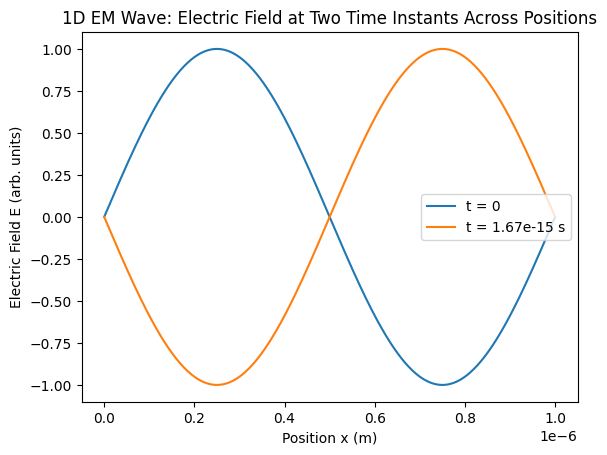

In [3]:
import numpy as np
import matplotlib.pyplot as plt

# Parameters for 1D wave
c = 3e8  # speed of light (m/s)
L = 1e-6  # domain length in meters
k = 2 * np.pi / L  # wave number
omega = c * k  # angular frequency

# Spatial grid
x = np.linspace(0, L, 500)

# Two time snapshots
t1 = 0.0
t2 = L / (2 * c)  # half period delay

E1 = np.sin(k * x - omega * t1)
E2 = np.sin(k * x - omega * t2)

plt.plot(x, E1)
plt.plot(x, E2)
plt.title('1D EM Wave: Electric Field at Two Time Instants Across Positions')
plt.xlabel('Position x (m)')
plt.ylabel('Electric Field E (arb. units)')
plt.legend(['t = 0', f't = {t2:.2e} s'])
plt.show()

**Resources**
- https://en.wikipedia.org/wiki/Electromagnetic_wave_equation

## Particle Model

The particle model of electomagnetic waves treats light as a stream of quanta ("photons"). This theory was first proposed by Albert Einstein in his 1905 paper on the photoelectric effect [https://guides.loc.gov/einstein-annus-mirabilis/1905-papers]. 

Einstein proposed that electromagnetic radiation of frequency $\nu\space (s^{-1})$ comes in discrete packets of energy $$E=h\nu$$ where $h=6.62607015 × 10^{-34 }\space m^2 kg / s$ is Planck's constant.

Before Einstein proposed applying quantization (converting a continuous range of values into a smaller, discrete set of values) to electromagnetic radiation, though, Planck had already introduce quantizing the energy in oscillators $(E=nh\nu)$ but treated the electomagnetic field itself as continuous. Planck's discovery came from his study of blackbody radiation in 1900, where he found that the classical theory predicted infinite energy at high frequencies (the "ultraviolet catastrophe"). To resolve this, he proposed that oscillators in the walls of the blackbody could only have discrete energy values. After Einstein extended quantization to the light field, Compton (1923) provided direct evidence of his theory by showing X-rays scatter off electrons with a wavelength shift. In his renowned experiment, Compton fired X-rays at graphite. He observed that the scattered X-rays had longer wavelengths than the incident ones, exactly as predicted by treating the X-rays as particles with momentum. This provided evidence supporting particle model of a wave.

The photoelectric effect, discussed frequently by Einstein, occurs when light of sufficient frequency strikes a metal surface and ejects electrons. This phenomenon has several properties that classical wave theory couldn't explain. The effect was first observed by Heinrich Hertz in 1887 while studying electromagnetic waves, though he didn't fully understand its implications. Later, Philipp Lenard conducted experiments in 1902 that revealed the puzzling properties of the effect.

First, there is a minimum frequency (threshold frequency) required to eject electrons, regardless of light intensity. Electrons are ejected immediately when light hits the surface, and the kinetic energy of ejected electrons depends on the frequency of the incident light. While higher intensity light doesn't increase electron energy, it does increase the number of electrons ejected. These observations contradicted classical wave theory, which predicted that higher intensity light should always eject electrons with more energy, regardless of frequency.
  
These observations directly supported Einstein's photon theory, as they showed that light energy comes in discrete packets (photons) rather than being continuously distributed. When a photon with energy E = hν hits an electron, it can transfer its energy if it exceeds the work function (minimum energy needed to free an electron from the metal). This revolutionary idea helped establish quantum theory and earned Einstein the Nobel Prize in 1921. The photoelectric effect was later used to develop practical devices like photomultiplier tubes and solar cells, demonstrating the real-world applications of quantum theory.

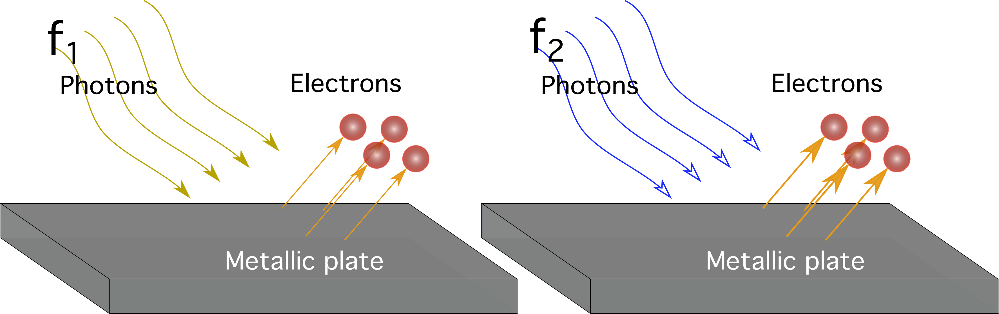

In [5]:
from IPython.display import Image, display

display(Image(filename='photoelectric.png'))

**Resources**
- https://phys.libretexts.org/Bookshelves/University_Physics/University_Physics_(OpenStax)/University_Physics_III_-_Optics_and_Modern_Physics_(OpenStax)/06%3A_Photons_and_Matter_Waves/6.04%3A_The_Compton_Effect
- https://pubs.aip.org/physicstoday/article/75/12/44/2848613/Arthur-Compton-and-the-mysteries-of-lightFor
- https://www.vaia.com/en-us/explanations/physics/radiation/electromagnetic-radiation-and-quantum-phenomena/

## Model Analysis

Both models of electromagnetic radiation provide valueable insight into its behavior. However, depending on the experimental context, one model may be preferred. 
 
  | Aspect | Wave Model | Particle Model |
  |--------|------------|----------------|
  | **Useful for** | Interference, diffraction, polarization | Photoelectric effect, Compton scattering |
  | **Evidence** | Young's double-slit fringes $I \propto \|E_1+E_2\|^2$ | Threshold frequency $(K_{max} = h\nu - \Phi)$; $\Delta\lambda = \frac{h}{m_ec}(1 - \cos\theta)$ |
  | **Governing Math** | Maxwell's wave eq.: $\nabla^2E - \frac{1}{c^2}\frac{\partial^2E}{\partial t^2} = 0$ | Photon relations: $E = h\nu$ $p = \frac{h}{\lambda}$ |
  | **When to Use** | Phenomena requiring continuous phase coherence | Phenomena requiring quantized energy/momentum exchange |

**Wave Model** | Strong and intuitive evidence for the wave model comes from Thomas Young's double-slit experiment [https://courses.lumenlearning.com/suny-physics/chapter/27-3-youngs-double-slit-experiment/] in which light passing through two slits creates pattern of bright and dark fringes. This pattern can only be explained by the wave nature of light because it's a result of the constructive and destructive interference of waves. The intensity of the pattern follows the equation $I \propto \|E_1+E_2\|^2$, where $E_1$ and $E_2$ are the electric fields from each slit. 

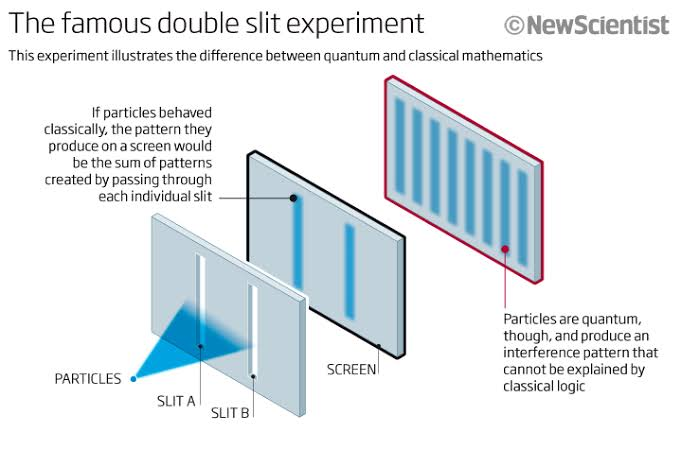

In [8]:
from IPython.display import Image, display

display(Image(filename='double_silt.jpeg'))

**Particle Model** | As for light's particle model, key evidence comes from the photoelectric effect [https://en.wikipedia.org/wiki/Photoelectric_effect]. When light hits a metal surface, electrons are ejected only if the light frequency exceeds a threshold value. The maximum kinetic energy of ejected electrons follows a discrete energy transfer that can only be explained by treating light as particles (photons) with energy $E = h\nu$.

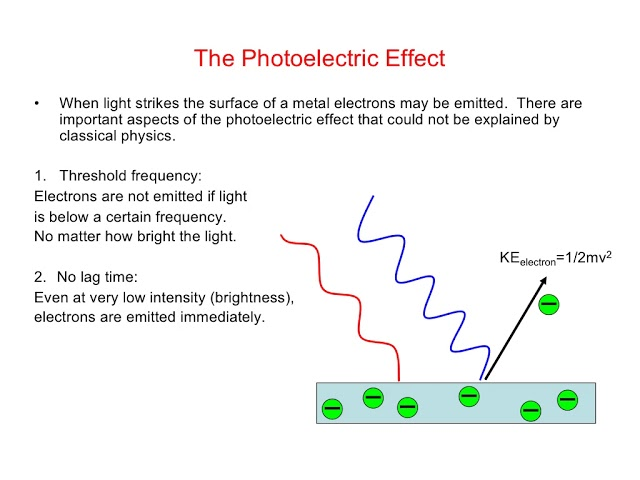

In [13]:
from IPython.display import Image, display

display(Image(filename='photoelectric_2.jpg'))